<a href="https://colab.research.google.com/github/him89088/Bar-Chart-Race/blob/master/bar_chart_race.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Mounting the Google Drive
Mount the google drive after authenticating

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


## Importing all the required libraries
Import the required libraries for loading the dataset and EDA

In [4]:
!pip install plotly_express

In [0]:
# Import required libraries
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
import numpy as np
import random
import plotly_express as px

from IPython.display import HTML

## Loading the dataset
Load the dataset into dataframe 'ani'

In [0]:
# Load the dataset
ani = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Data/Refugees-Population.csv')

### Creating a new column Index
Creating the new column Index to act as an index

In [7]:
# Create a new column 'Index' to be used for colors
ani['Index'] = ani.reset_index().index
ani

,Year,Country,Origin,Asylum-seekers,Internally displaced persons,Others of concern,Refugees (incl. refugee-like situations),Returned IDPs,Returned refugees,Stateless persons,Total Refugees,Total Population,Index
0,1960,Austria,Various/Unknown,0.0,0.0,0.0,39000.0,0.0,0.0,0.0,39000.0,7047539.0,0
1,1960,Belgium,Various/Unknown,0.0,0.0,0.0,55000.0,0.0,0.0,0.0,55000.0,9153489.0,1
2,1960,Canada,Various/Unknown,0.0,0.0,0.0,48629.0,0.0,0.0,0.0,48629.0,17909009.0,2
3,1960,Congo,Angola,0.0,0.0,0.0,150000.0,0.0,0.0,0.0,150000.0,16266504.0,3
4,1960,Denmark,Various/Unknown,0.0,0.0,0.0,2300.0,0.0,0.0,0.0,2300.0,4579603.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
130119,2018,Zimbabwe,South Sudan,0.0,0.0,0.0,8.0,0.0,0.0,0.0,8.0,14439018.0,130119
130120,2018,Zimbabwe,Sudan,28.0,0.0,0.0,0.0,0.0,0.0,0.0,28.0,14439018.0,130120
130121,2018,Zimbabwe,Uganda,0.0,0.0,0.0,7.0,0.0,0.0,0.0,7.0,14439018.0,130121
130122,2018,Zimbabwe,Zambia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14439018.0,130122


## Calculating number of Refugees per capita
We wanted to check number of Refugees per capita for each country. To do so, we divide Total Refugee Population with Total Population of Refugee-Host Nation. Further, we calculate number of Refugees per capita 100,000 persons. To do so, we multiply Refugees per capita by 100,000.

In [9]:
# Calculating Refugees per Capita
ani['RefPerCap'] = ani['Total Refugees'] / ani['Total Population'] 

# Replacing inf with NaN and then filling NaN with 0
ani = ani.replace([np.inf, -np.inf], np.nan)
ani = ani.fillna(0)

# Calculating Refugees per capita 100k
ani['PerCap100k'] = ani.RefPerCap * (10 ** 5)
ani

,Year,Country,Origin,Asylum-seekers,Internally displaced persons,Others of concern,Refugees (incl. refugee-like situations),Returned IDPs,Returned refugees,Stateless persons,Total Refugees,Total Population,Index,RefPerCap,PerCap100k
0,1960,Austria,Various/Unknown,0.0,0.0,0.0,39000.0,0.0,0.0,0.0,39000.0,7047539.0,0,5.533847e-03,553.384664
1,1960,Belgium,Various/Unknown,0.0,0.0,0.0,55000.0,0.0,0.0,0.0,55000.0,9153489.0,1,6.008638e-03,600.863780
2,1960,Canada,Various/Unknown,0.0,0.0,0.0,48629.0,0.0,0.0,0.0,48629.0,17909009.0,2,2.715337e-03,271.533729
3,1960,Congo,Angola,0.0,0.0,0.0,150000.0,0.0,0.0,0.0,150000.0,16266504.0,3,9.221404e-03,922.140369
4,1960,Denmark,Various/Unknown,0.0,0.0,0.0,2300.0,0.0,0.0,0.0,2300.0,4579603.0,4,5.022269e-04,50.222694
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130119,2018,Zimbabwe,South Sudan,0.0,0.0,0.0,8.0,0.0,0.0,0.0,8.0,14439018.0,130119,5.540543e-07,0.055405
130120,2018,Zimbabwe,Sudan,28.0,0.0,0.0,0.0,0.0,0.0,0.0,28.0,14439018.0,130120,1.939190e-06,0.193919
130121,2018,Zimbabwe,Uganda,0.0,0.0,0.0,7.0,0.0,0.0,0.0,7.0,14439018.0,130121,4.847975e-07,0.048480
130122,2018,Zimbabwe,Zambia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14439018.0,130122,0.000000e+00,0.000000


## Creating a color dictionary
Since there were over 190 countries, assigning a color to each manually would be an exhausting task. So, we decided to create a dictionary with Index and randomly generated color as key/value pairs. Furthermore, we created another dictionary by grouping the dataframe by Country and use that as key for every index as its value.



In [0]:
# Create a list of unique indices
ls = list(ani['Index'].unique())

# Create a list of randomly generated colors
color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(len(ls))]

# Create a dictionary with ls/color as key/value pari
dict_col = dict(zip(ls, color))

# Create another dictionary with grouped Country and Index as key/value pairs
group = ani.set_index('Country')['Index'].to_dict()

## Bar Chart Race Plot
This is the main function for Bar Chart Race Plot. It takes Year as its argument. It does the following: 
1. Find the top 10 Refugee-host Nations for each year followed by inverting the values. 
2. Create a horizontal bar chart with refugee-host nations on Y-Axis and Total Refugees on X-Axis and coloring each bar based on the dictionary created earlier. 
3. Assigns the Origin country as well as the total refugee population to the tip of each bar 
4. Display the year on the right 
5. Set the X-Axis on the top and sets the label for both axes 
6. Create a grid for X-Axis with '-' style 
7. Removes the right and bottome spines 
8. Sets the heading for the chart 
9. Puts the authors name, as well as credits the original authors

In [0]:
# Function to create Bar Chart Race with year as its argument
def draw_barchart_totref(year):
    # Find the top 10 Refugee-host Nations for each year followed by inverting the values.
    ani_df = ani[ani['Year'].eq(year)].sort_values(by='Total Refugees', ascending=False).drop_duplicates(subset='Country', keep="first").head(10)
    ani_df = ani_df[::-1]
    
    # Clears the axes with each itearation
    ax.clear()
    
    # Create a horizontal bar chart with refugee-host nations on Y-Axis and Total Refugees on X-Axis and coloring each bar based on the dictionary created earlier. 
    ax.barh(ani_df['Country'], ani_df['Total Refugees'], color=[dict_col[group[x]] for x in ani_df['Country']])
    
    # Assigns the Origin country as well as the total refugee population to the tip of each bar
    for i, (value, name) in enumerate(zip(ani_df['Total Refugees'], ani_df['Origin'])):
        ax.text(value, i,     name,           size=14, weight=600, ha='left', va='bottom')
        ax.text(value, i,     f'{value:,.0f}',  size=14, va='top')
    
    # Display the year on the right
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    
    # Set the X-Axis on the top and sets the label for both axes
    ax.xaxis.set_ticks_position('top')
    ax.xaxis.set_label_text('Refugee Population', size=20, weight=200)
    ax.yaxis.set_label_text('Refugee-Host Nations', size=20, weight=200 )
    ax.tick_params(axis='both', labelsize =16)
    ax.margins(0, 0.01)
    
    # Create a grid for X-Axis with '-' style
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    
    # Removes the right and bottome spines 
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    # Sets the heading for the chart
    ax.text(0.3, 1.12, 'Total Refugees arrived from 1960 to 2018',
            transform=ax.transAxes, size=24, weight=600)
    
    # Puts the authors name, as well as credits the original authors
    ax.text(1, 0, 'by @him89088; credit @jburnmurdoch, @pratapvardhan', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))

    

### Plotting the graph
We create a figure of size (25,12) and use FuncAnimation from Matplotlib.animation library. The arguments we are passing are figure, our function to draw the barchart, frames for years, ranginng from 1960 - 2018. Finally, we animate our graph.

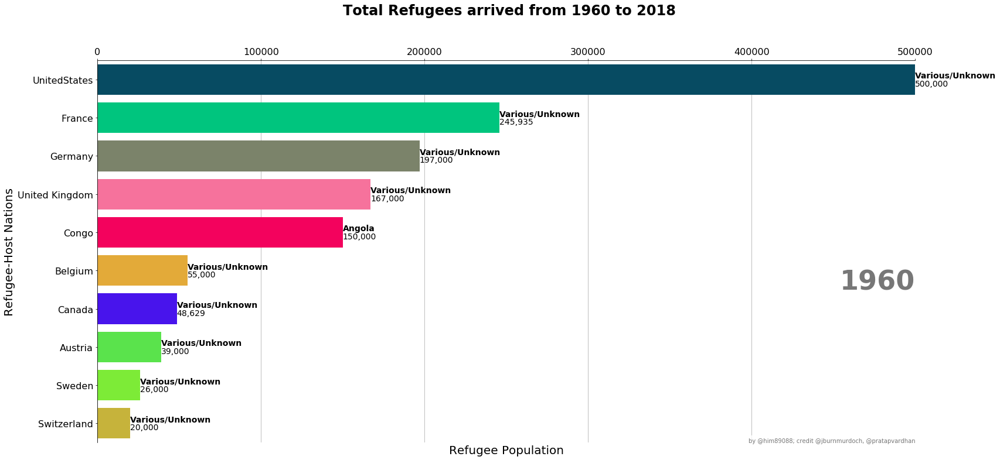

In [12]:
# Create figure
fig, ax = plt.subplots(figsize=(25, 12))

# Stores the animation to a variable
animator_totref = animation.FuncAnimation(fig, draw_barchart_totref, frames=range(1960, 2019))

### Animating the plotted graph

In [13]:
# Animate our graph
HTML(animator_totref.to_jshtml()) 

### Plotting the second graph
We create another barchart race, this time between number of refugees per capita 100k and Refugee-host nation

In [0]:
# Function to create Bar Chart Race with year as its argument
def draw_barchart_percap(year):
    
    # Find the top 10 Refugee-host Nations by refugee per capita 100k for each year followed by inverting the values.
    ani_df = ani[ani['Year'].eq(year)].sort_values(by='PerCap100k', ascending=False).drop_duplicates(subset='Country', keep="first").head(10)
    ani_df = ani_df[::-1]
    
    # Clears the axes with each itearation
    ax.clear()
    
    # Create a horizontal bar chart with refugee-host nations on Y-Axis and Total Refugees on X-Axis and coloring each bar based on the dictionary created earlier.
    ax.barh(ani_df['Country'], ani_df['PerCap100k'], color=[dict_col[group[x]] for x in ani_df['Country']])
    
    # Assigns the Origin country as well as the total refugee population to the tip of each bar
    for i, (value, name) in enumerate(zip(ani_df['PerCap100k'], ani_df['Origin'])):
        ax.text(value, i,     name,           size=14, weight=600, ha='left', va='bottom')
        ax.text(value, i,     f'{value:,.0f}',  size=14, va='top')
    
    # Display the year on the right
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    
    # Set the X-Axis on the top and sets the label for both axes
    ax.xaxis.set_ticks_position('top')
    ax.xaxis.set_label_text('Refugee Population', size=20, weight=200)
    ax.yaxis.set_label_text('Refugee-Host Nations', size=20, weight=200 )
    ax.tick_params(axis='both', labelsize =16)
    ax.margins(0, 0.01)
    
    # Create a grid for X-Axis with '-' style
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    
    # Removes the right and bottome spines 
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    # Sets the heading for the chart
    ax.text(0.3, 1.12, 'Refugees arrived per 100k from 1960 to 2018',
            transform=ax.transAxes, size=24, weight=600)
    
    # Puts the authors name, as well as credits the original authors
    ax.text(1, 0, 'by @him89088; credit @jburnmurdoch, @pratapvardhan', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))

    

### Plotting the second graph
We create a figure of size (25,12) and use FuncAnimation from Matplotlib.animation library. The arguments we are passing are figure, our function to draw the barchart, frames for years, ranginng from 1960 - 2018. Finally, we animate our graph.

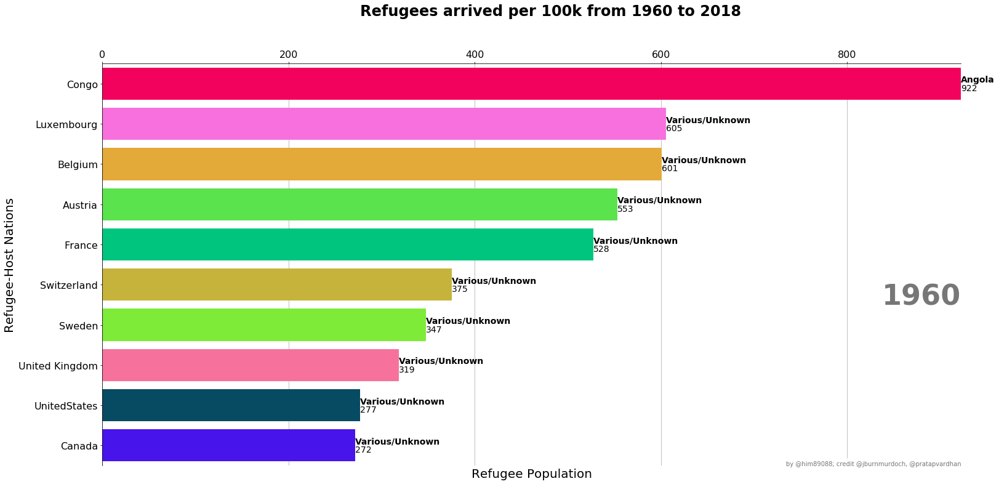

In [15]:
# Create figure
fig, ax = plt.subplots(figsize=(25, 12))

# Stores the animation to a variable
animator_percap = animation.FuncAnimation(fig, draw_barchart_percap, frames=range(1960, 2019))

### Animating the plotted graph

In [16]:
# Animate our graph
HTML(animator_percap.to_jshtml()) 

## Bubble Plot
Finally, we created an animated bubble plot, inspired from Gapminder, using Plotly Express. We took Refugees per cap 100k on X-Axis and total Population of the refugee-host nation on Y-Axis. We animated using Year as the frame and grouped by the Refugee-host nation. We added hover effect based on Origin country and colored each bubble based on Refugee-host nation. The size of each bubble is according to the total population, with max size as 100.

In [17]:
# Creating the animated bubble plot
fig = px.scatter(ani,x="PerCap100k", y="Total Population",
           animation_frame="Year", animation_group="Country", 
           hover_name="Origin", render_mode="svg", color="Country",
           size="Total Population",log_x = True,
           size_max=100)

# Displaying our plot
fig.show()